In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image
import cv2

import imageio
import matplotlib.image as mpimg
from imgaug import augmenters as iaa
from tqdm import tqdm

import tensorflow as tf
sns.set()

# import os
# print(os.listdir("../input"))

import warnings
warnings.filterwarnings("ignore")

2024-02-19 22:49:08.354035: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-02-19 22:49:08.638311: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-19 22:49:08.638401: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-19 22:49:08.674160: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-19 22:49:08.742761: I tensorflow/core/platform/cpu_feature_guar

In [2]:
train_labels = pd.read_csv("train.csv")
train_labels.head()

,Id,Target
0,00070df0-bbc3-11e8-b2bc-ac1f6b6435d0,16 0
1,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0,7 1 2 0
2,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0,5
3,000c99ba-bba4-11e8-b2b9-ac1f6b6435d0,1
4,001838f8-bbca-11e8-b2bc-ac1f6b6435d0,18


In [3]:
test_path = "test/"
submission = pd.read_csv("sample_submission.csv")
print(submission.head())
test_names = submission.Id.values
print(len(test_names))
print(test_names[0])

                                     Id  Predicted
0  00008af0-bad0-11e8-b2b8-ac1f6b6435d0          0
1  0000a892-bacf-11e8-b2b8-ac1f6b6435d0          0
2  0006faa6-bac7-11e8-b2b7-ac1f6b6435d0          0
3  0008baca-bad7-11e8-b2b9-ac1f6b6435d0          0
4  000cce7e-bad4-11e8-b2b8-ac1f6b6435d0          0
11702
00008af0-bad0-11e8-b2b8-ac1f6b6435d0


In [4]:
label_names = {
    0:  "Nucleoplasm",  
    1:  "Nuclear membrane",   
    2:  "Nucleoli",   
    3:  "Nucleoli fibrillar center",   
    4:  "Nuclear speckles",
    5:  "Nuclear bodies",   
    6:  "Endoplasmic reticulum",   
    7:  "Golgi apparatus",   
    8:  "Peroxisomes",   
    9:  "Endosomes",   
    10:  "Lysosomes",   
    11:  "Intermediate filaments",   
    12:  "Actin filaments",   
    13:  "Focal adhesion sites",   
    14:  "Microtubules",   
    15:  "Microtubule ends",   
    16:  "Cytokinetic bridge",   
    17:  "Mitotic spindle",   
    18:  "Microtubule organizing center",   
    19:  "Centrosome",   
    20:  "Lipid droplets",   
    21:  "Plasma membrane",   
    22:  "Cell junctions",   
    23:  "Mitochondria",   
    24:  "Aggresome",   
    25:  "Cytosol",   
    26:  "Cytoplasmic bodies",   
    27:  "Rods & rings"
}

In [5]:
reverse_train_labels = dict((v,k) for k,v in label_names.items())
reverse_train_labels

{'Nucleoplasm': 0,
 'Nuclear membrane': 1,
 'Nucleoli': 2,
 'Nucleoli fibrillar center': 3,
 'Nuclear speckles': 4,
 'Nuclear bodies': 5,
 'Endoplasmic reticulum': 6,
 'Golgi apparatus': 7,
 'Peroxisomes': 8,
 'Endosomes': 9,
 'Lysosomes': 10,
 'Intermediate filaments': 11,
 'Actin filaments': 12,
 'Focal adhesion sites': 13,
 'Microtubules': 14,
 'Microtubule ends': 15,
 'Cytokinetic bridge': 16,
 'Mitotic spindle': 17,
 'Microtubule organizing center': 18,
 'Centrosome': 19,
 'Lipid droplets': 20,
 'Plasma membrane': 21,
 'Cell junctions': 22,
 'Mitochondria': 23,
 'Aggresome': 24,
 'Cytosol': 25,
 'Cytoplasmic bodies': 26,
 'Rods & rings': 27}

In [6]:
train_labels['Target'] = train_labels['Target'].apply(lambda x : x.split() if pd.notna(x) else [])
train_labels['Target'] = train_labels['Target'].apply(lambda x : [int(i) for i in x])

In [7]:
train_labels.head()

,Id,Target
0,00070df0-bbc3-11e8-b2bc-ac1f6b6435d0,"[16, 0]"
1,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0,"[7, 1, 2, 0]"
2,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0,[5]
3,000c99ba-bba4-11e8-b2b9-ac1f6b6435d0,[1]
4,001838f8-bbca-11e8-b2bc-ac1f6b6435d0,[18]


In [8]:
for v, k in reverse_train_labels.items():
    train_labels[v] = [1 if k in row else 0 for row in train_labels['Target']]
train_labels.head()

,Id,Target,Nucleoplasm,Nuclear membrane,Nucleoli,Nucleoli fibrillar center,Nuclear speckles,Nuclear bodies,Endoplasmic reticulum,Golgi apparatus,...,Microtubule organizing center,Centrosome,Lipid droplets,Plasma membrane,Cell junctions,Mitochondria,Aggresome,Cytosol,Cytoplasmic bodies,Rods & rings
0,00070df0-bbc3-11e8-b2bc-ac1f6b6435d0,"[16, 0]",1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0,"[7, 1, 2, 0]",1,1,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0,[5],0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
3,000c99ba-bba4-11e8-b2b9-ac1f6b6435d0,[1],0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,001838f8-bbca-11e8-b2bc-ac1f6b6435d0,[18],0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0


In [9]:
test_labels = pd.DataFrame(data=test_names, columns=["Id"])
for col in train_labels.columns.values:
    if col != "Id":
        test_labels[col] = 0
test_labels.head()

,Id,Target,Nucleoplasm,Nuclear membrane,Nucleoli,Nucleoli fibrillar center,Nuclear speckles,Nuclear bodies,Endoplasmic reticulum,Golgi apparatus,...,Microtubule organizing center,Centrosome,Lipid droplets,Plasma membrane,Cell junctions,Mitochondria,Aggresome,Cytosol,Cytoplasmic bodies,Rods & rings
0,00008af0-bad0-11e8-b2b8-ac1f6b6435d0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0000a892-bacf-11e8-b2b8-ac1f6b6435d0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0006faa6-bac7-11e8-b2b7-ac1f6b6435d0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0008baca-bad7-11e8-b2b9-ac1f6b6435d0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,000cce7e-bad4-11e8-b2b8-ac1f6b6435d0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


<Axes: >

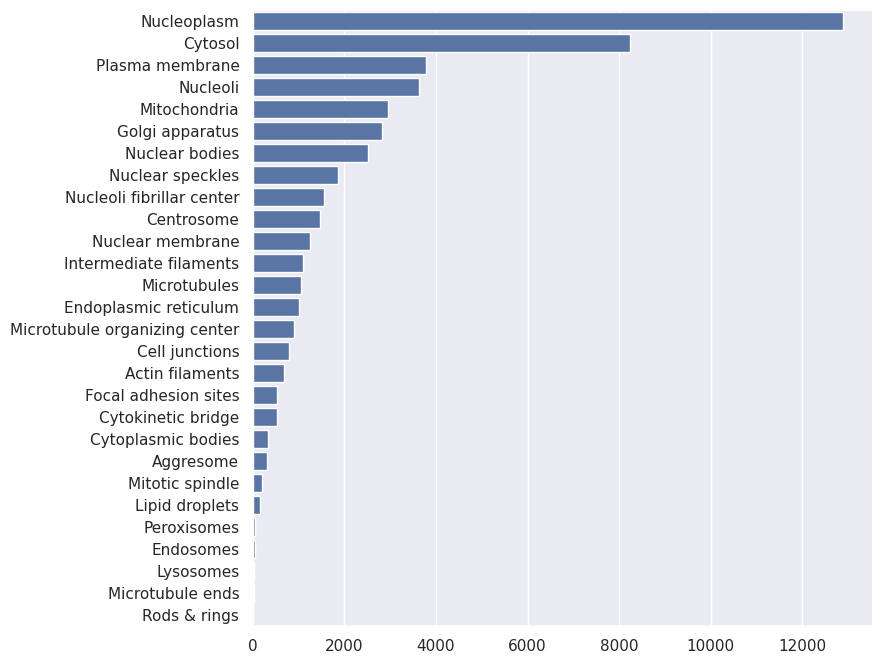

In [10]:
target_counts = train_labels.drop(["Id", "Target"],axis=1).sum(axis=0).sort_values(ascending=False) #vertically
plt.figure(figsize=(8,8))
sns.barplot(y=target_counts.index.values, x=target_counts.values, order=target_counts.index)

Text(0, 0.5, '% of train data')

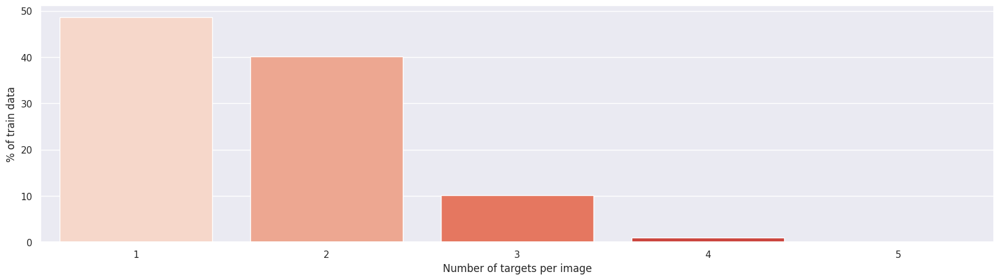

In [11]:
train_labels["number_of_targets"] = train_labels.drop(["Id", "Target"],axis=1).sum(axis=1) #horizontally
count_perc = np.round(100 * train_labels["number_of_targets"].value_counts() / train_labels.shape[0], 2)
plt.figure(figsize=(20,5))
sns.barplot(x=count_perc.index.values, y=count_perc.values, palette="Reds")
plt.xlabel("Number of targets per image")
plt.ylabel("% of train data")

<Axes: >

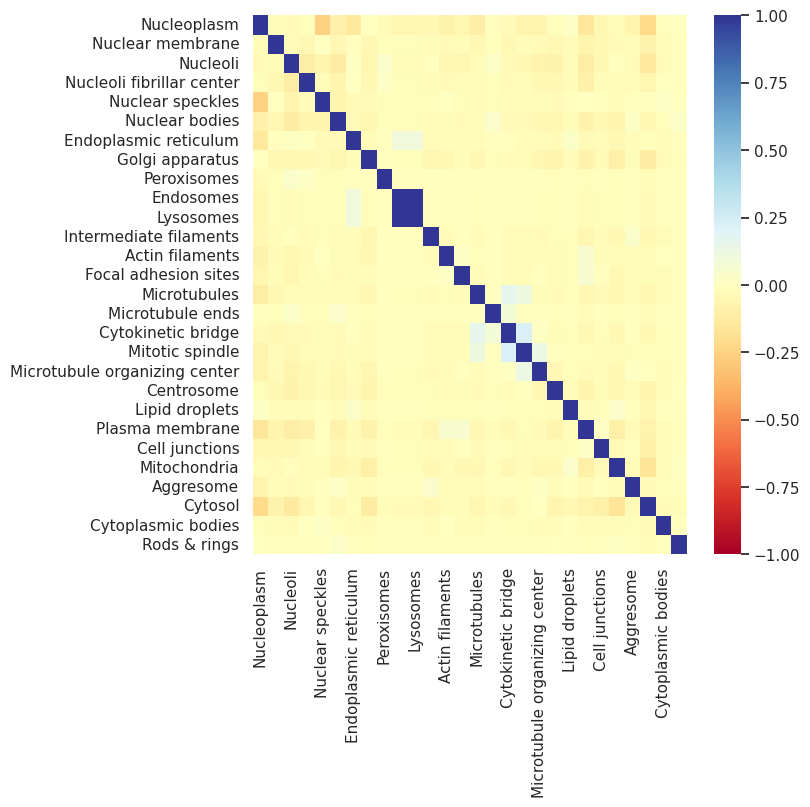

In [12]:
plt.figure(figsize=(7,7))
sns.heatmap(train_labels[train_labels.number_of_targets>1].drop(
    ["Id", "Target", "number_of_targets"],axis=1
).corr(), cmap="RdYlBu", vmin=-1, vmax=1)

In [13]:
def find_counts(special_target, labels):
    counts = labels[labels[special_target] == 1].drop(
        ["Id", "Target", "number_of_targets"],axis=1
    ).sum(axis=0)
    counts = counts[counts > 0]
    counts = counts.sort_values()
    return counts

Text(0, 0.5, 'Counts in train data')

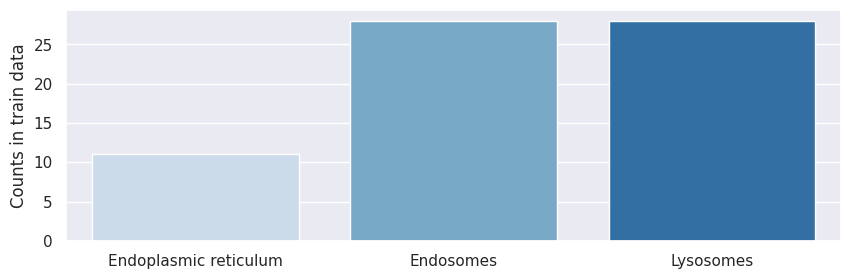

In [14]:
lyso_endo_counts = find_counts("Lysosomes", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=lyso_endo_counts.index.values, y=lyso_endo_counts.values, palette="Blues")
plt.ylabel("Counts in train data")


Text(0, 0.5, 'Counts in train data')

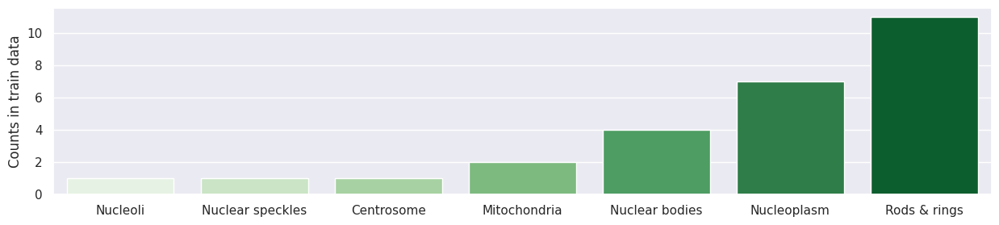

In [15]:
rod_rings_counts = find_counts("Rods & rings", train_labels)
plt.figure(figsize=(15,3))
sns.barplot(x=rod_rings_counts.index.values, y=rod_rings_counts.values, palette="Greens")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

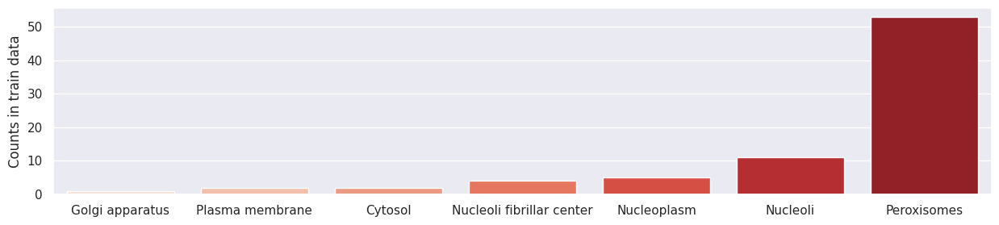

In [16]:
peroxi_counts = find_counts("Peroxisomes", train_labels)
plt.figure(figsize=(15,3))
sns.barplot(x=peroxi_counts.index.values, y=peroxi_counts.values, palette="Reds")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

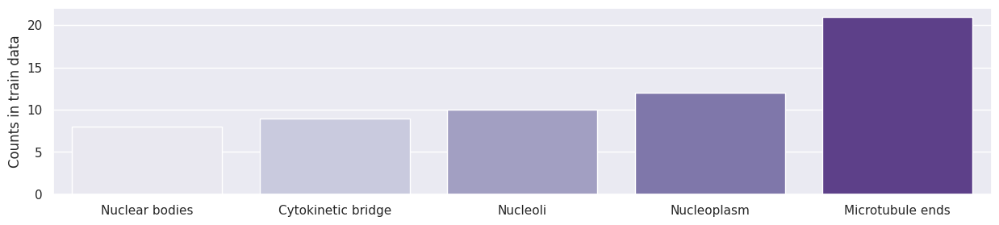

In [17]:
tubeends_counts = find_counts("Microtubule ends", train_labels)
plt.figure(figsize=(15,3))
sns.barplot(x=tubeends_counts.index.values, y=tubeends_counts.values, palette="Purples")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

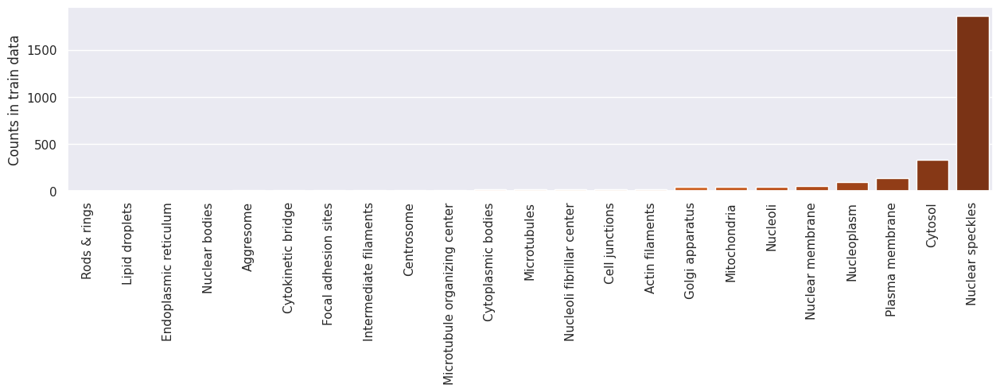

In [18]:
nuclear_speckles_counts = find_counts("Nuclear speckles", train_labels)
plt.figure(figsize=(15,3))
sns.barplot(x=nuclear_speckles_counts.index.values, y=nuclear_speckles_counts.values, palette="Oranges")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

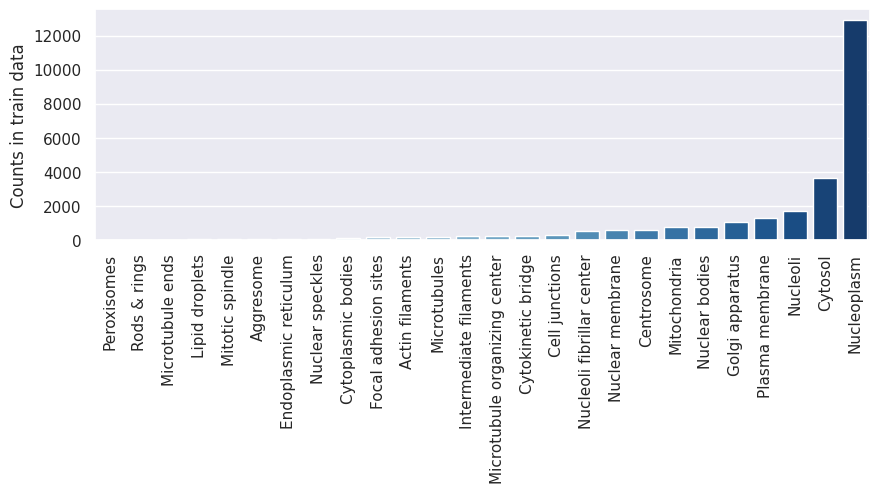

In [21]:
nucleoplasm_counts = find_counts("Nucleoplasm", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=nucleoplasm_counts.index.values, y=nucleoplasm_counts.values, palette="Blues")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

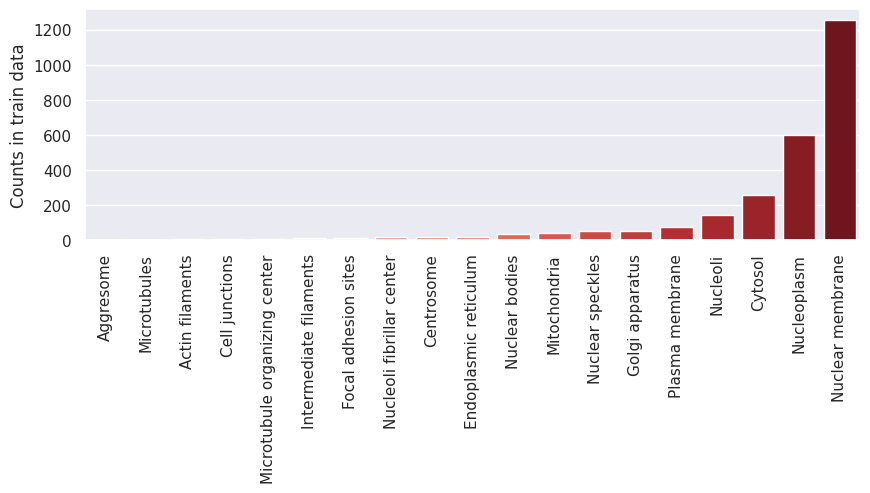

In [22]:
nuclearmembrane_counts = find_counts("Nuclear membrane", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=nuclearmembrane_counts.index.values, y=nuclearmembrane_counts.values, palette="Reds")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

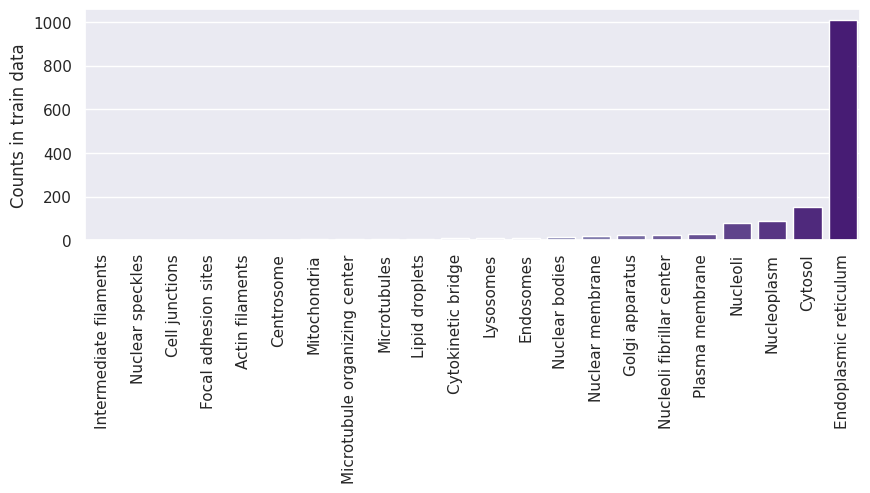

In [23]:
endoreti_counts = find_counts("Endoplasmic reticulum", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=endoreti_counts.index.values, y=endoreti_counts.values, palette="Purples")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

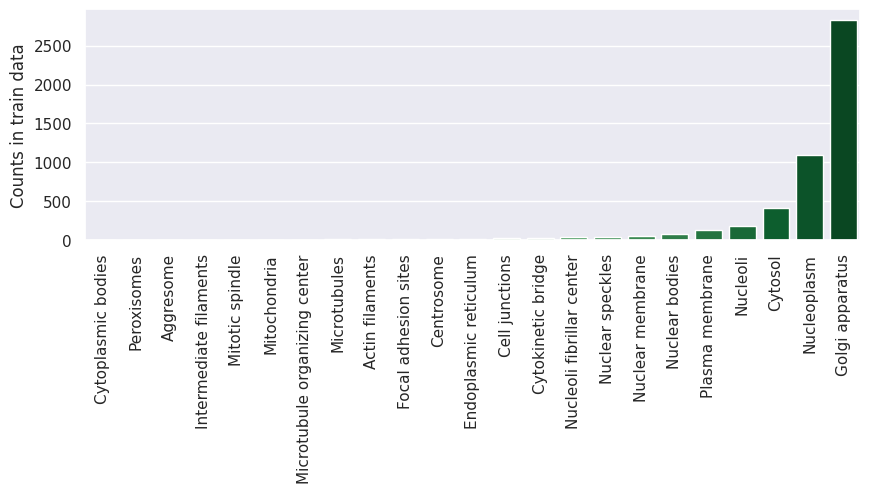

In [24]:
golgiapp_counts = find_counts("Golgi apparatus", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=golgiapp_counts.index.values, y=golgiapp_counts.values, palette="Greens")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

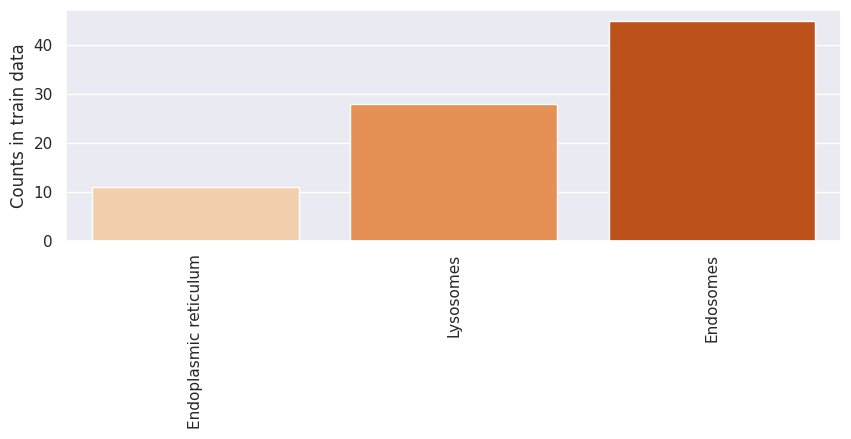

In [25]:
endosomes_counts = find_counts("Endosomes", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=endosomes_counts.index.values, y=endosomes_counts.values, palette="Oranges")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

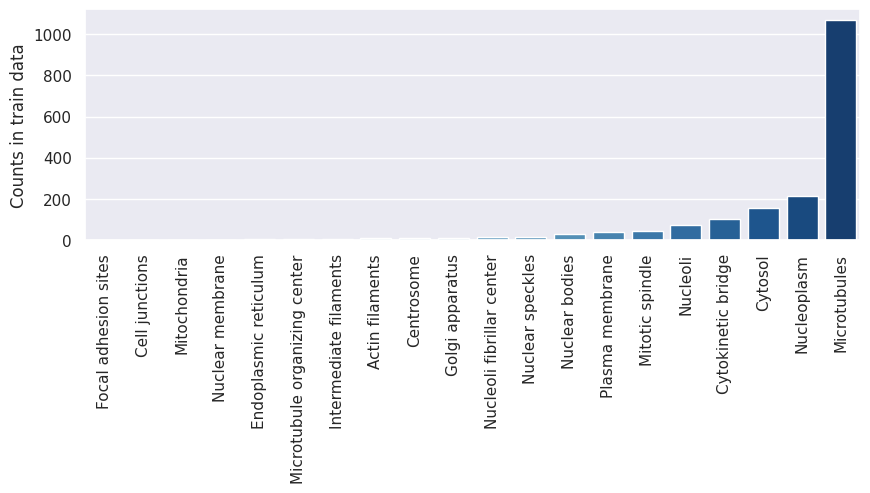

In [26]:
microtubules_counts = find_counts("Microtubules", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=microtubules_counts.index.values, y=microtubules_counts.values, palette="Blues")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

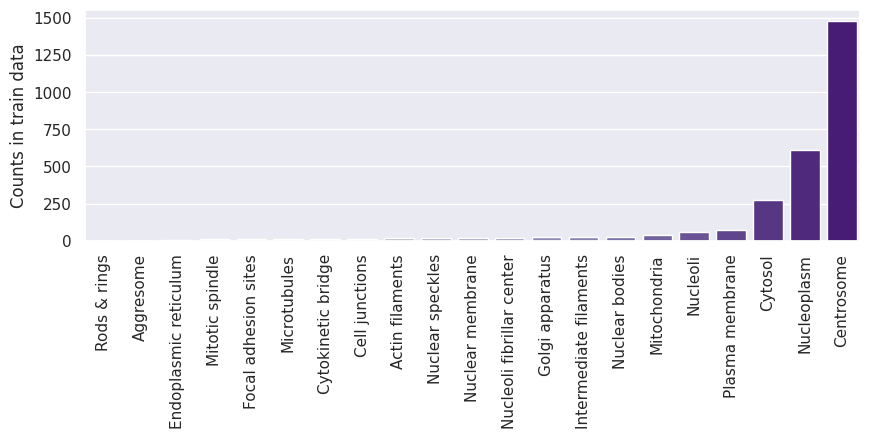

In [27]:
centrosomes_counts = find_counts("Centrosome", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=centrosomes_counts.index.values, y=centrosomes_counts.values, palette="Purples")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

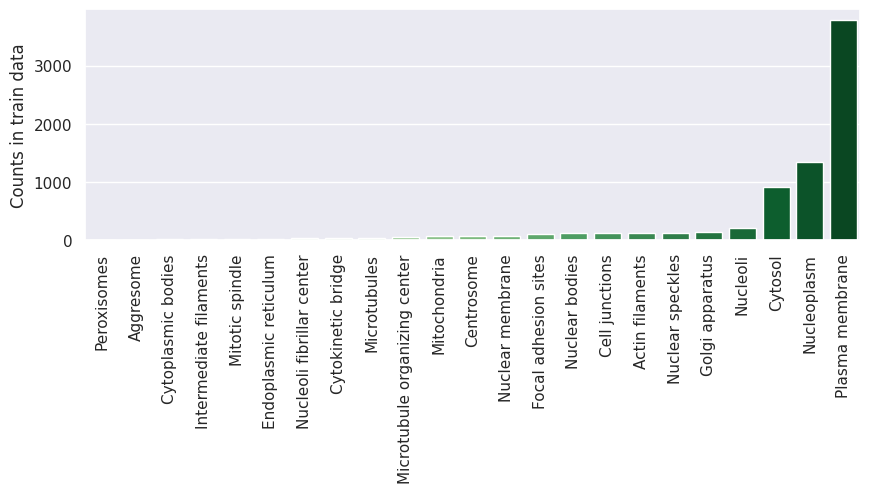

In [28]:
plasmamem_counts = find_counts("Plasma membrane", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=plasmamem_counts.index.values, y=plasmamem_counts.values, palette="Greens")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

Text(0, 0.5, 'Counts in train data')

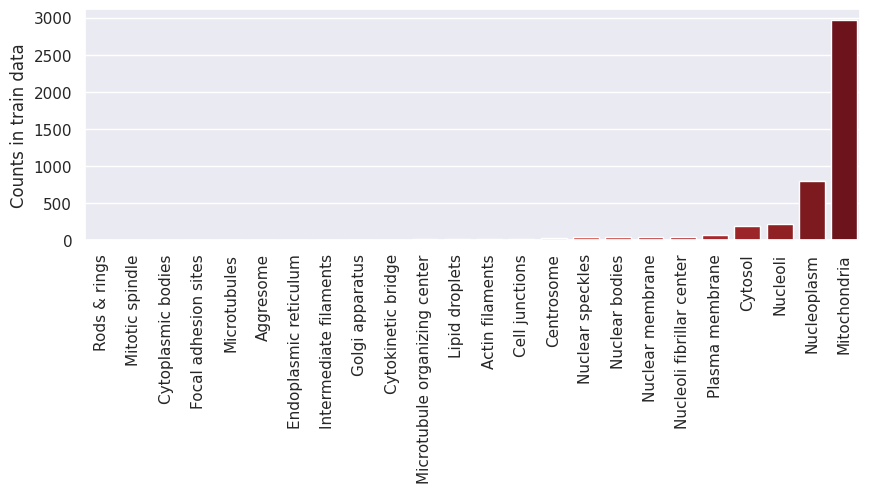

In [29]:
mitochondria_counts = find_counts("Mitochondria", train_labels)
plt.figure(figsize=(10,3))
sns.barplot(x=mitochondria_counts.index.values, y=mitochondria_counts.values, palette="Reds")
plt.xticks(rotation="vertical")
plt.ylabel("Counts in train data")

In [30]:
from os import listdir

files = listdir("train")
for n in range(10):
    print(files[n])

355f8190-bb9f-11e8-b2b9-ac1f6b6435d0_yellow.png
4c491582-bbc3-11e8-b2bc-ac1f6b6435d0_yellow.png
6ff91a1c-bb9c-11e8-b2b9-ac1f6b6435d0_yellow.png
99298fb4-bbb7-11e8-b2ba-ac1f6b6435d0_blue.png
7bd10470-bbc0-11e8-b2bb-ac1f6b6435d0_green.png
42521d2e-bbbb-11e8-b2ba-ac1f6b6435d0_blue.png
c0d1dc68-bbb4-11e8-b2ba-ac1f6b6435d0_green.png
449f51e8-bbaf-11e8-b2ba-ac1f6b6435d0_green.png
e262f03e-bbae-11e8-b2ba-ac1f6b6435d0_yellow.png
7b8b190c-bbab-11e8-b2ba-ac1f6b6435d0_green.png


In [31]:
import re
files = listdir("train")
for n in files:
    if re.search("5e3a2e6a-bb9c-11e8-b2b9-ac1f6b6435d0", n):
        print(n)

5e3a2e6a-bb9c-11e8-b2b9-ac1f6b6435d0_yellow.png
5e3a2e6a-bb9c-11e8-b2b9-ac1f6b6435d0_red.png
5e3a2e6a-bb9c-11e8-b2b9-ac1f6b6435d0_green.png
5e3a2e6a-bb9c-11e8-b2b9-ac1f6b6435d0_blue.png


In [32]:
print(train_labels.shape[0])
print(len(files)//4)
print(len(files))

31072
31072
124289


In [33]:
train_path = "train/"
def load_image(basepath, image_id):
    images = np.zeros(shape=(4, 512, 512))
    images[0, :, :] = imageio.imread(basepath + image_id + "_green" + ".png")
    images[1, :, :] = imageio.imread(basepath + image_id + "_red" + ".png")
    images[2, :, :] = imageio.imread(basepath + image_id + "_blue" + ".png")
    images[3, :, :] = imageio.imread(basepath + image_id + "_yellow" + ".png")
    return images

def make_image_row(image, subax, title):
    subax[0].imshow(image[0], cmap="Greens")
    subax[1].imshow(image[1], cmap="Reds")
    subax[2].imshow(image[2], cmap="Blues")
    subax[3].imshow(image[3], cmap="Oranges")
    subax[0].set_title(title)
    subax[1].set_title("stained microtubules")
    subax[2].set_title("stained nucleus")
    subax[3].set_title("stained endoplasmatic reticulum")
    return subax

def make_title(file_id):
    file_targets = train_labels.loc[train_labels.Id==file_id, "Target"].values[0]
    title = " - "
    for n in file_targets:
        title += label_names[n] + " - "
    return title

class TargetGroupIterator:
    
    def __init__(self, target_names, batch_size, basepath):
        self.target_names = target_names
        self.target_list = [reverse_train_labels[key] for key in target_names]
        self.batch_shape = (batch_size, 4, 512, 512)
        self.basepath = basepath
    
    def find_matching_data_entries(self):
        train_labels["check_col"] = train_labels.Target.apply(
            lambda l: self.check_subset(l)
        )
        self.images_identifier = train_labels[train_labels.check_col==1].Id.values
        train_labels.drop("check_col", axis=1, inplace=True)

    def check_subset(self, targets):
        return np.where(set(targets).issubset(set(self.target_list)), 1, 0)
    
    def get_loader(self):
        filenames = []
        idx = 0
        images = np.zeros(self.batch_shape)
        for image_id in self.images_identifier:
            images[idx,:,:,:] = load_image(self.basepath, image_id)
            filenames.append(image_id)
            idx += 1
            if idx == self.batch_shape[0]:
                yield filenames, images
                filenames = []
                images = np.zeros(self.batch_shape)
                idx = 0
        if idx > 0:
            yield filenames, images

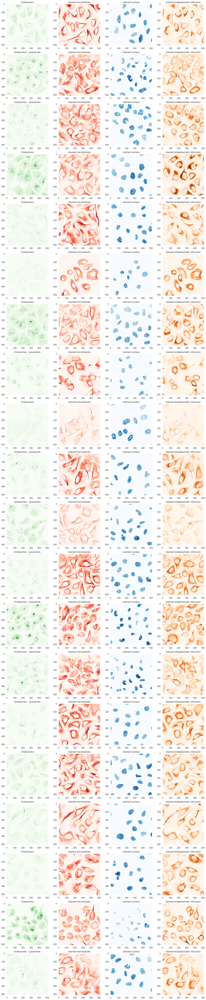

In [37]:
your_choice = ["Lysosomes", "Endosomes"]
your_batch_size = 20
imageloader = TargetGroupIterator(your_choice, your_batch_size, train_path)
imageloader.find_matching_data_entries()
iterator = imageloader.get_loader()
file_ids, images = next(iterator)

fig, ax = plt.subplots(len(file_ids),4,figsize=(20,5*len(file_ids)))
if ax.shape == (4,):
    ax = ax.reshape(1,-1)
for n in range(len(file_ids)):
    make_image_row(images[n], ax[n], make_title(file_ids[n]))

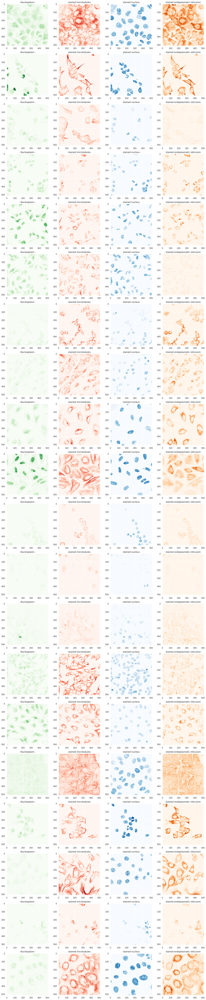

In [38]:
your_choice = ["Rods & rings", "Nucleoplasm"]
your_batch_size = 20
imageloader = TargetGroupIterator(your_choice, your_batch_size, train_path)
imageloader.find_matching_data_entries()
iterator = imageloader.get_loader()
file_ids, images = next(iterator)

fig, ax = plt.subplots(len(file_ids),4,figsize=(20,5*len(file_ids)))
if ax.shape == (4,):
    ax = ax.reshape(1,-1)
for n in range(len(file_ids)):
    make_image_row(images[n], ax[n], make_title(file_ids[n]))

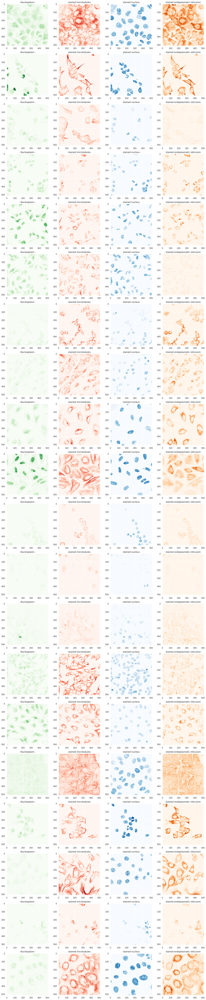

In [39]:
your_choice = ["Microtubule ends", "Nucleoplasm"]
your_batch_size = 20
imageloader = TargetGroupIterator(your_choice, your_batch_size, train_path)
imageloader.find_matching_data_entries()
iterator = imageloader.get_loader()
file_ids, images = next(iterator)

fig, ax = plt.subplots(len(file_ids),4,figsize=(20,5*len(file_ids)))
if ax.shape == (4,):
    ax = ax.reshape(1,-1)
for n in range(len(file_ids)):
    make_image_row(images[n], ax[n], make_title(file_ids[n]))

In [40]:
INPUT_SHAPE = (299,299,3)
BATCH_SIZE = 10

In [41]:
import os

path_to_train = 'train/'
data = pd.read_csv('train.csv')

train_dataset_info = []
for name, labels in zip(data['Id'], data['Target'].str.split(' ')):
    train_dataset_info.append({
        'path':os.path.join(path_to_train, name),
        'labels':np.array([int(label) for label in labels])})
train_dataset_info = np.array(train_dataset_info)

In [42]:
train_dataset_info

array([{'path': 'train/00070df0-bbc3-11e8-b2bc-ac1f6b6435d0', 'labels': array([16,  0])},
       {'path': 'train/000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0', 'labels': array([7, 1, 2, 0])},
       {'path': 'train/000a9596-bbc4-11e8-b2bc-ac1f6b6435d0', 'labels': array([5])},
       ...,
       {'path': 'train/fff189d8-bbab-11e8-b2ba-ac1f6b6435d0', 'labels': array([7])},
       {'path': 'train/fffdf7e0-bbc4-11e8-b2bc-ac1f6b6435d0', 'labels': array([25,  2, 21])},
       {'path': 'train/fffe0ffe-bbc0-11e8-b2bb-ac1f6b6435d0', 'labels': array([2, 0])}],
      dtype=object)

In [43]:
train_dataset_info.shape

(31072,)

In [44]:
from sklearn.model_selection import train_test_split
train_ids, test_ids, train_targets, test_target = train_test_split(
    data['Id'], data['Target'], test_size=0.2, random_state=42)

In [45]:
class data_generator:
    
    def create_train(dataset_info, batch_size, shape, augument=True):
        assert shape[2] == 3
        while True:
            random_indexes = np.random.choice(len(dataset_info), batch_size)
            batch_images = np.empty((batch_size, shape[0], shape[1], shape[2]))
            batch_labels = np.zeros((batch_size, 28)) # Creating label tensors for each batch where all 28 values are originally zero
            for i, idx in enumerate(random_indexes):
                image = data_generator.load_image(
                    dataset_info[idx]['path'], shape)   
                if augument:
                    image = data_generator.augment(image)
                batch_images[i] = image
                batch_labels[i][dataset_info[idx]['labels']] = 1 # Change those values to one which are present in the image
            yield batch_images, batch_labels

    # We club the four color channels into one image and that to our set. This can be seen below where we visualise the first five images in our set
    def load_image(path, shape):
        R = np.array(Image.open(path+'_red.png'))
        G = np.array(Image.open(path+'_green.png'))
        B = np.array(Image.open(path+'_blue.png'))
        Y = np.array(Image.open(path+'_yellow.png'))

        image = np.stack((
            R/2 + Y/2, 
            G/2 + Y/2, 
            B),-1)
        
        image = cv2.resize(image, (shape[0], shape[1])) # resizing the image
        image = np.divide(image, 255) # Normalising the image
        return image

    # Random augmentation based modification. This means each image appended to our set is rotated or flipped by some degree if augmentation is set to True which it is.
    def augment(image):
        augment_img = iaa.Sequential([
            iaa.OneOf([
                iaa.Affine(rotate=0),
                iaa.Affine(rotate=90),
                iaa.Affine(rotate=180),
                iaa.Affine(rotate=270),
                iaa.Fliplr(0.5),
                iaa.Flipud(0.5),
            ])], random_order=True)
        
        image_aug = augment_img.augment_image(image)
        return image_aug

In [46]:
# create train datagen
train_datagen = data_generator.create_train(
    train_dataset_info, 5, (299,299,3), augument=True)

min: 0.0, max: 1.0


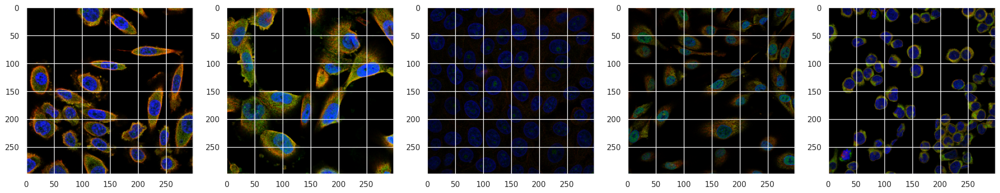

In [47]:
images, labels = next(train_datagen)

fig, ax = plt.subplots(1,5,figsize=(25,5))
for i in range(5):
    ax[i].imshow(images[i])
print('min: {0}, max: {1}'.format(images.min(), images.max()))

In [48]:
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential, load_model
from keras.layers import Activation
from keras.layers import Dropout
from keras.layers import Flatten
from keras.layers import Dense
from keras.layers import Input
from keras.layers import BatchNormalization
from keras.layers import Conv2D
from keras.models import Model
from keras.applications import InceptionResNetV2
from keras.callbacks import ModelCheckpoint
from keras.callbacks import LambdaCallback
from keras.callbacks import Callback
from keras import metrics
from keras.optimizers import Adam 
from keras import backend as K
import tensorflow as tf
import keras

In [49]:
def create_model(input_shape, n_out):
    
    pretrain_model = InceptionResNetV2(
        include_top=False, 
        weights='imagenet', 
        input_shape=input_shape)    
    
    input_tensor = Input(shape=input_shape)
    bn = BatchNormalization()(input_tensor)
    x = pretrain_model(bn)
    x = Conv2D(128, kernel_size=(1,1), activation='relu')(x)
    x = Flatten()(x)
    x = Dropout(0.5)(x)
    x = Dense(512, activation='relu')(x)
    x = Dropout(0.5)(x)
    output = Dense(n_out, activation='sigmoid')(x)
    model = Model(input_tensor, output)
    
    return model

In [50]:
# def f1(y_true, y_pred):
#     tp = K.sum(K.cast(y_true*y_pred, 'float'), axis=0)
#     fp = K.sum(K.cast((1-y_true)*y_pred, 'float'), axis=0)
#     fn = K.sum(K.cast(y_true*(1-y_pred), 'float'), axis=0)

#     p = tp / (tp + fp + K.epsilon())
#     r = tp / (tp + fn + K.epsilon())

#     f1 = 2*p*r / (p+r+K.epsilon())
#     f1 = tf.where(tf.is_nan(f1), tf.zeros_like(f1), f1)
#     return K.mean(f1)

import tensorflow as tf
from tensorflow.keras import backend as K
import numpy as np

def f1(y_true, y_pred):
    tp = K.sum(K.cast(y_true*y_pred, 'float'), axis=0)
    fp = K.sum(K.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = K.sum(K.cast(y_true*(1-y_pred), 'float'), axis=0)

    p = tp / (tp + fp + K.epsilon())
    r = tp / (tp + fn + K.epsilon())

    f1 = 2*p*r / (p+r+K.epsilon())
    f1 = tf.where(tf.math.is_nan(f1), tf.zeros_like(f1), f1)
    return K.mean(f1)


In [51]:
def show_history(history):
    fig, ax = plt.subplots(1, 3, figsize=(15,3))
    ax[0].set_title('loss')
    ax[0].plot(history.epoch, history.history["loss"], label="Train loss")
    ax[0].plot(history.epoch, history.history["val_loss"], label="Validation loss")
    ax[1].set_title('f1')
    ax[1].plot(history.epoch, history.history["f1"], label="Train f1")
    ax[1].plot(history.epoch, history.history["val_f1"], label="Validation f1")
    ax[2].set_title('acc')
    ax[2].plot(history.epoch, history.history["acc"], label="Train acc")
    ax[2].plot(history.epoch, history.history["val_acc"], label="Validation acc")
    ax[0].legend()
    ax[1].legend()
    ax[2].legend()

In [52]:
keras.backend.clear_session()

model = create_model(
    input_shape=(299,299,3), 
    n_out=28)

model.summary()

2024-02-19 22:56:47.927492: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:274] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected


Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 299, 299, 3)]     0         
                                                                 
 batch_normalization_203 (B  (None, 299, 299, 3)       12        
 atchNormalization)                                              
                                                                 
 inception_resnet_v2 (Funct  (None, 8, 8, 1536)        54336736  
 ional)                                                          
                                                                 
 conv2d_203 (Conv2D)         (None, 8, 8, 128)         196736    
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dropout (Dropout)           (None, 8192)              0     

In [53]:
train_generator = data_generator.create_train(
    train_dataset_info[train_ids.index], BATCH_SIZE, INPUT_SHAPE, augument=False)
validation_generator = data_generator.create_train(
    train_dataset_info[test_ids.index], 256, INPUT_SHAPE, augument=False)

In [54]:
train_generator

<generator object data_generator.create_train at 0x7fb09a458f90>

In [55]:
checkpointer = ModelCheckpoint(
    'InceptionResNetV2.model',
    verbose=2, save_best_only=True)

train_generator = data_generator.create_train(
    train_dataset_info[train_ids.index], BATCH_SIZE, INPUT_SHAPE, augument=True)
validation_generator = data_generator.create_train(
    train_dataset_info[test_ids.index], 256, INPUT_SHAPE, augument=True)

model.layers[2].trainable = False

model.compile(
    loss='binary_crossentropy',  
    optimizer=Adam(1e-4),
    metrics=['acc', f1])

history = model.fit_generator(
    train_generator,
    steps_per_epoch=100,
    validation_data=next(validation_generator),
    epochs=10, 
    verbose=1,
    callbacks=[checkpointer])

Epoch 1/10
100/100 [==============================] - ETA: 0s - loss: 0.2769 - acc: 0.1850 - f1: 0.0504
Epoch 1: val_loss improved from inf to 0.18181, saving model to InceptionResNetV2.model
INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


100/100 [==============================] - 488s 5s/step - loss: 0.2769 - acc: 0.1850 - f1: 0.0504 - val_loss: 0.1818 - val_acc: 0.3867 - val_f1: 0.0541
Epoch 2/10
100/100 [==============================] - ETA: 0s - loss: 0.2169 - acc: 0.2730 - f1: 0.0502
Epoch 2: val_loss improved from 0.18181 to 0.18153, saving model to InceptionResNetV2.model
INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


100/100 [==============================] - 504s 5s/step - loss: 0.2169 - acc: 0.2730 - f1: 0.0502 - val_loss: 0.1815 - val_acc: 0.3867 - val_f1: 0.0536
Epoch 3/10
100/100 [==============================] - ETA: 0s - loss: 0.2048 - acc: 0.2350 - f1: 0.0478
Epoch 3: val_loss improved from 0.18153 to 0.17840, saving model to InceptionResNetV2.model
INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


100/100 [==============================] - 508s 5s/step - loss: 0.2048 - acc: 0.2350 - f1: 0.0478 - val_loss: 0.1784 - val_acc: 0.3906 - val_f1: 0.0511
Epoch 4/10
100/100 [==============================] - ETA: 0s - loss: 0.2011 - acc: 0.2790 - f1: 0.0474
Epoch 4: val_loss improved from 0.17840 to 0.17619, saving model to InceptionResNetV2.model
INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


100/100 [==============================] - 510s 5s/step - loss: 0.2011 - acc: 0.2790 - f1: 0.0474 - val_loss: 0.1762 - val_acc: 0.3828 - val_f1: 0.0527
Epoch 5/10
100/100 [==============================] - ETA: 0s - loss: 0.1983 - acc: 0.2500 - f1: 0.0491
Epoch 5: val_loss improved from 0.17619 to 0.17516, saving model to InceptionResNetV2.model
INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


100/100 [==============================] - 509s 5s/step - loss: 0.1983 - acc: 0.2500 - f1: 0.0491 - val_loss: 0.1752 - val_acc: 0.3867 - val_f1: 0.0520
Epoch 6/10
100/100 [==============================] - ETA: 0s - loss: 0.1952 - acc: 0.3000 - f1: 0.0474
Epoch 6: val_loss did not improve from 0.17516
100/100 [==============================] - 433s 4s/step - loss: 0.1952 - acc: 0.3000 - f1: 0.0474 - val_loss: 0.1765 - val_acc: 0.3867 - val_f1: 0.0502
Epoch 7/10
100/100 [==============================] - ETA: 0s - loss: 0.1913 - acc: 0.2920 - f1: 0.0465
Epoch 7: val_loss improved from 0.17516 to 0.17484, saving model to InceptionResNetV2.model
INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


100/100 [==============================] - 516s 5s/step - loss: 0.1913 - acc: 0.2920 - f1: 0.0465 - val_loss: 0.1748 - val_acc: 0.3906 - val_f1: 0.0516
Epoch 8/10
100/100 [==============================] - ETA: 0s - loss: 0.1931 - acc: 0.2770 - f1: 0.0469
Epoch 8: val_loss improved from 0.17484 to 0.17409, saving model to InceptionResNetV2.model
INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


100/100 [==============================] - 535s 5s/step - loss: 0.1931 - acc: 0.2770 - f1: 0.0469 - val_loss: 0.1741 - val_acc: 0.3828 - val_f1: 0.0487
Epoch 9/10
100/100 [==============================] - ETA: 0s - loss: 0.1885 - acc: 0.3140 - f1: 0.0478
Epoch 9: val_loss improved from 0.17409 to 0.17372, saving model to InceptionResNetV2.model
INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


100/100 [==============================] - 547s 5s/step - loss: 0.1885 - acc: 0.3140 - f1: 0.0478 - val_loss: 0.1737 - val_acc: 0.3711 - val_f1: 0.0510
Epoch 10/10
100/100 [==============================] - ETA: 0s - loss: 0.1893 - acc: 0.3140 - f1: 0.0481
Epoch 10: val_loss improved from 0.17372 to 0.17287, saving model to InceptionResNetV2.model
INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


INFO:tensorflow:Assets written to: InceptionResNetV2.model/assets


100/100 [==============================] - 549s 6s/step - loss: 0.1893 - acc: 0.3140 - f1: 0.0481 - val_loss: 0.1729 - val_acc: 0.3945 - val_f1: 0.0520


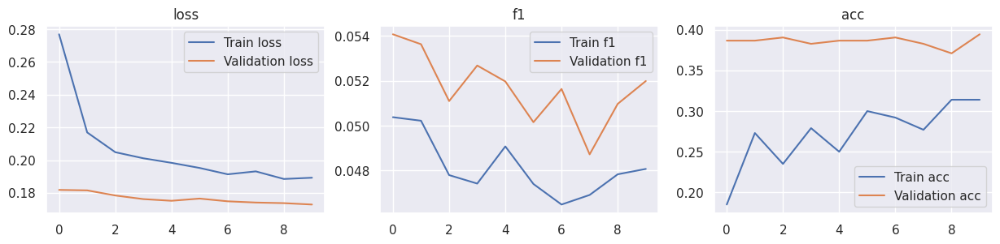

In [56]:
show_history(history)

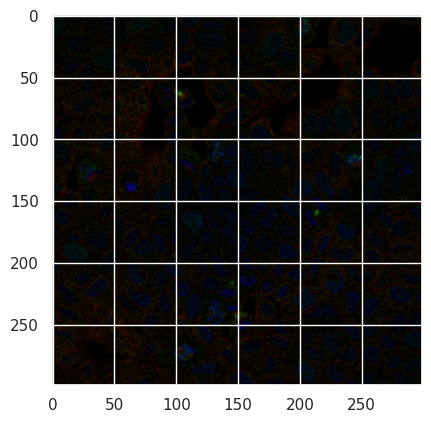

In [57]:
path = os.path.join('train','00070df0-bbc3-11e8-b2bc-ac1f6b6435d0')
image = data_generator.load_image(path, INPUT_SHAPE)
plt.imshow(image)

In [58]:
def generate_classes(image,model):
    score_predict = model.predict(image[np.newaxis])[0]
    label_predict = np.arange(28)[score_predict>=0.1]
    str_predict_label = ' '.join(str(l) for l in label_predict)
    return str_predict_label
result = generate_classes(image,model)
result_ = result.split(' ')

1/1 [==============================] - 2s 2s/step


In [59]:
linter = []
for i in result_:
    linter.append(label_names[int(i)])
print(result)
print(linter)

0 25
['Nucleoplasm', 'Cytosol']


In [60]:
model.save('InceptionResNetV2.h5')

In [61]:
import pickle

In [62]:
# Save the model in pickle format
with open('InceptionResNetV2.pkl', 'wb') as f:
    pickle.dump(model, f)